<a href="https://colab.research.google.com/github/mredelis/CAP4453-Robot-Vision-Spr23/blob/main/RV_HW1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#**Homework 1**

1. Upload a personal image in hosting place that can be accesed using an URL. In case you can find access, pick an image from an URL already available. The image must be different to any of the used in the tutorial. Display the image making sure that the image has the channels in the right order [20%]

2. Exchange the red and green channels and display the image with the inverted channels [20%]


Original Image


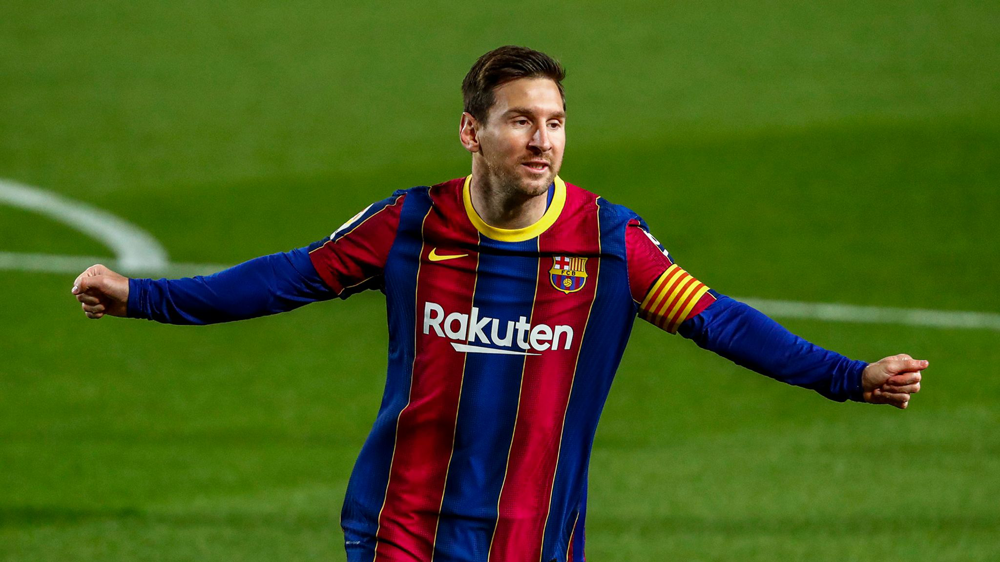



Image with red and green channels exchanged


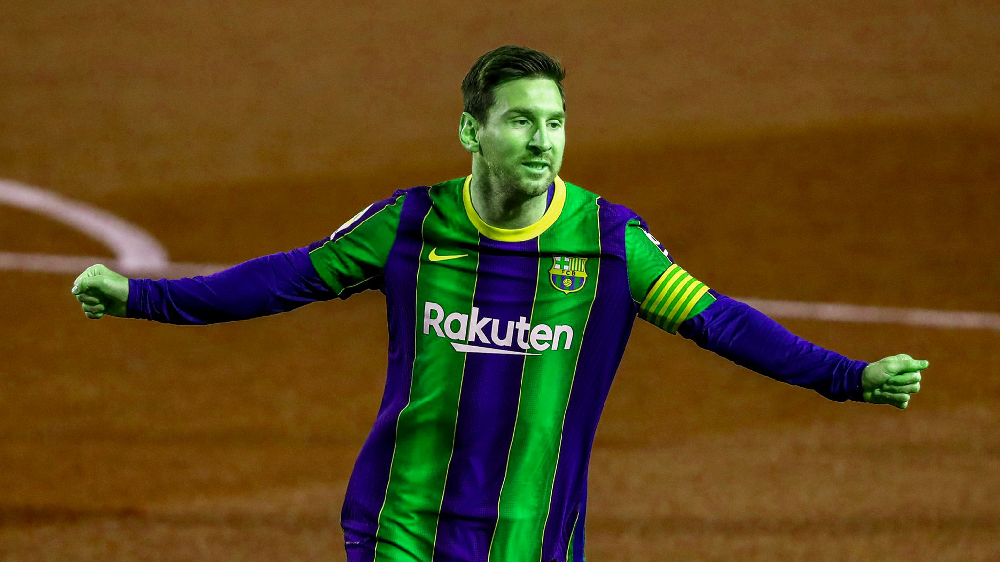

In [ ]:
# Insert code for read, switch, and display image here
import numpy as np
import pandas as pd
import cv2 as cv 
from google.colab.patches import cv2_imshow # for image display
from skimage import io
from PIL import Image 
import matplotlib.pylab as plt   

# yourUrl = "https://www.color-hex.com/palettes/3661.png"
yourUrl = "https://e3.365dm.com/21/04/2048x1152/football-messi-lionel_5359730.jpg"
image = io.imread(yourUrl)  
# cv2_imshow(image) #image read in format RGB 
image = cv.cvtColor(image, cv.COLOR_BGR2RGB) # convert to BGR
print('Original Image')
cv2_imshow(image) 
print('\n')

# represents image as NumPy arrays with channels in Blue, Green, Red ordering rather than Red, Green, Blue
(b, g, r) = cv.split(image)
# merge the image back together again
image_merged = cv.merge([b, r, g])

print('Image with red and green channels exchanged')
cv2_imshow(image_merged)

3. Visualize an histogram for each color channel of the upper half of the image [20%]

Original Image Height:  1152
Upper Half Image Height:  576


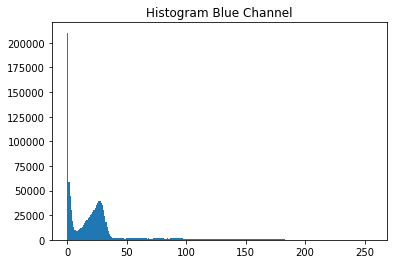

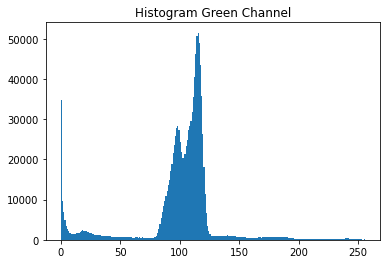

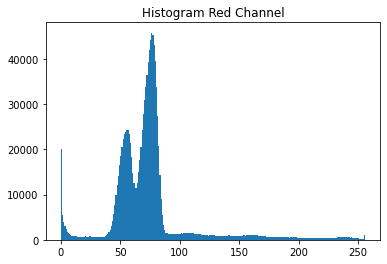

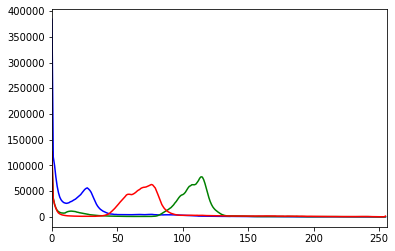

In [ ]:
# you can use slicing to select the half part of the image
height = image.shape[0]
print("Original Image Height: ", height)
newImage = image[0:height//2,:,:]
print("Upper Half Image Height: ", newImage.shape[0])
# cv2_imshow(newImage) 
# print('\n')

# plt.hist(newImage.ravel(),bins = 256, range = [0,256]) 
# plt.show()

plt.hist(newImage[:,:,0].ravel(),bins = 256, range = [0, 256])
plt.title('Histogram Blue Channel')
plt.show()
print('\n')
plt.title('Histogram Green Channel')
plt.hist(newImage[:,:,1].ravel(),bins = 256, range = [0, 256])
plt.show()
print('\n')
plt.title('Histogram Red Channel')
plt.hist(newImage[:,:,2].ravel(),bins = 256, range = [0, 256])
plt.show()

# get the histogram
color = ('b','g','r')
for i,col in enumerate(color):
    histr = cv.calcHist([image],[i],None,[256],[0,256])
    plt.plot(histr,color = col)
    plt.xlim([0,256])
plt.show()
     

4. Convert the image to CIELab color [5%].

 a. Create a new image with added value of 10 in the L channel, and convert it back to the BGR color space to visualize it. [5%] (make sure to use the right data type, and that your image makes sense)

 b. Create a new image with substracted value of 10 in the L channel, and convert it back to BGR to visualize it. [5%] (make sure to use the right data type, and that your image makes sense)
 
 c. Create a new image with added value of 10 in the a channel, and convert it back to BGR to visualize it.  [5%]  (make sure to use the right data type, and that your image makes sense)

uint8
float32


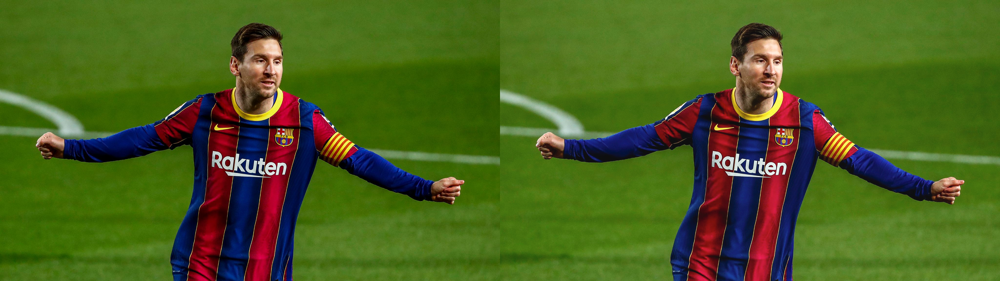

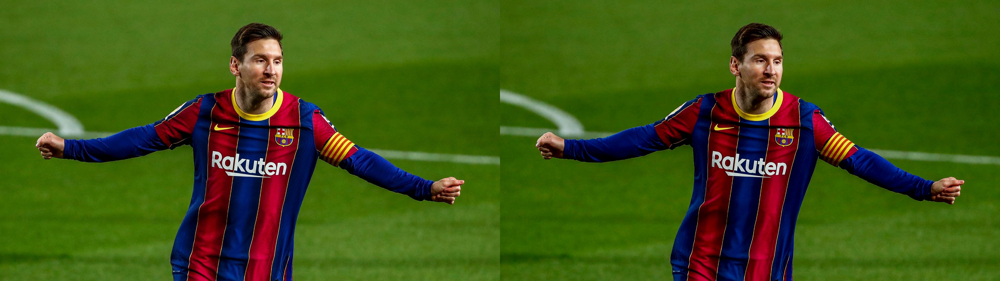

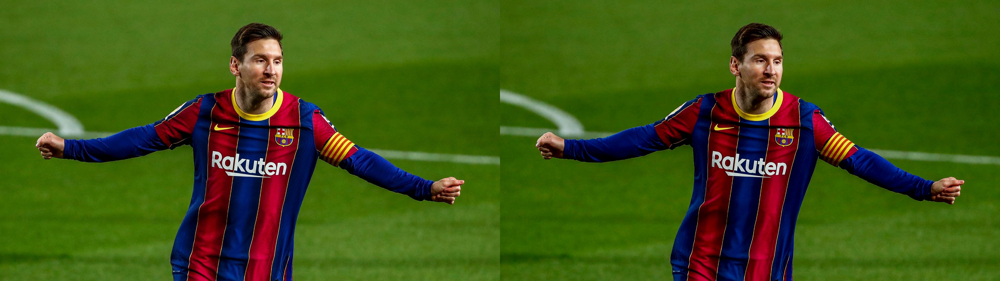

In [ ]:
# convert image to CIELab
imgcie = cv.cvtColor(image, cv.COLOR_BGR2LAB)
print(imgcie.dtype)
imgcie = imgcie.astype(np.float32)
print(imgcie.dtype)

# print(imgcie[:, :, 0].min())
# print(imgcie[:, :, 0].max())
# print(imgcie[:, :, 1].min())
# print(imgcie[:, :, 1].max())
# print(imgcie[:, :, 2].min())
# print(imgcie[:, :, 2].max())

# cv2_imshow(image)
# cv2_imshow(imgcie)

imgcieNewA = np.copy(imgcie)
imgcieNewB = np.copy(imgcie)
imgcieNewC = np.copy(imgcie)

imgcieNewA[:, :, 0] = imgcie[:, :, 0] + 10
imgcieNewB[:, :, 0] = imgcie[:, :, 0] - 10
imgcieNewC[:, :, 1] = imgcie[:, :, 1] + 10

imgcieNewA[imgcieNewA < 0] = 0
imgcieNewA[imgcieNewA > 255] = 255
imgcieNewB[imgcieNewB < 0] = 0
imgcieNewB[imgcieNewB > 255] = 255
imgcieNewC[imgcieNewC < 0] = 0
imgcieNewC[imgcieNewC > 255] = 255

# imgcie = cv.cvtColor(imgcie.astype(np.uint8), cv.COLOR_LAB2BGR)
imgcieNewA = cv.cvtColor(imgcieNewA.astype(np.uint8), cv.COLOR_LAB2BGR)
imgcieNewB = cv.cvtColor(imgcieNewB.astype(np.uint8), cv.COLOR_LAB2BGR)
imgcieNewC = cv.cvtColor(imgcieNewC.astype(np.uint8), cv.COLOR_LAB2BGR)

final_frameA = cv.hconcat((image, imgcieNewA))
cv2_imshow(final_frameA)
print('\n')

final_frameB = cv.hconcat((image, imgcieNewB))
cv2_imshow(final_frameB)
print('\n')

final_frameC = cv.hconcat((image, imgcieNewB))
cv2_imshow(final_frameC)
print('\n')

5. Show histograms for each channel of the images generated in the exercise 4. Compare these histograms with the original histograms. Comment about the differences and write son conclussions about it. [20%]

Plot 1: Original Image


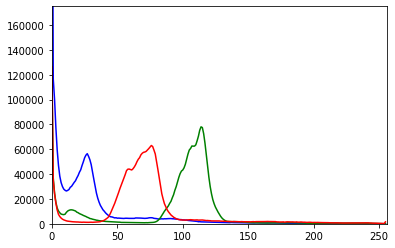



Plot 2: Image converted to CIELab color with added value of 10 in L channel


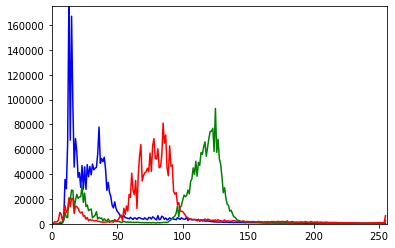



Plot 3: Image converted to CIELab color with subtracted value of 10 in L channel


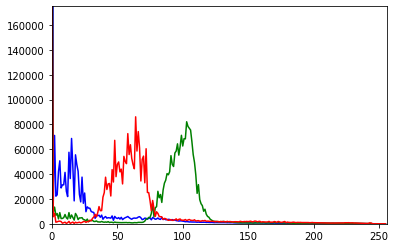



Plot 4: Image converted to CIELab color with added value of 10 in a channel


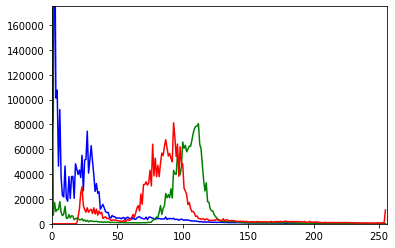

In [ ]:
# your histograms go here
print('Plot 1: Original Image')
color = ('b','g','r')
for i,col in enumerate(color):
    histr = cv.calcHist([image],[i],None,[256],[0,256])
    plt.plot(histr,color = col)
    plt.xlim([0,256])
    plt.ylim([0, 175000])
plt.show()
print('\n')

print('Plot 2: Image converted to CIELab color with added value of 10 in L channel')
color = ('b','g','r')
for i,col in enumerate(color):
    histr = cv.calcHist([imgcieNewA],[i],None,[256],[0,256])
    plt.plot(histr,color = col)
    plt.xlim([0,256])
    plt.ylim([0, 175000])
plt.show()
print('\n')

print('Plot 3: Image converted to CIELab color with subtracted value of 10 in L channel')
color = ('b','g','r')
for i,col in enumerate(color):
    histr = cv.calcHist([imgcieNewB],[i],None,[256],[0,256])
    plt.plot(histr,color = col)
    plt.xlim([0,256])
    plt.ylim([0, 175000])
plt.show()
print('\n')

print('Plot 4: Image converted to CIELab color with added value of 10 in a channel')
color = ('b','g','r')
for i,col in enumerate(color):
    histr = cv.calcHist([imgcieNewC],[i],None,[256],[0,256])
    plt.plot(histr,color = col)
    plt.xlim([0,256])
    plt.ylim([0, 175000])
plt.show()
print('\n')


In the 4 plots, we can observe that all the channels have low intensity (x-axis values) given that all of them are in the range ~ [0, 120]. This corresponds to the dark blue and red of the jersey stripes. The green channel, on the other hand, has a mid-tone as it lays more or less in the middle of the x-axis.

In Plots 2 and 3, the color part of the image (a* and b* values) was not manipulated but the brigtness component (L* value). We can see how the image is darker in the plot 3 because of the value of L is lower than in Plot 2

In Plot 4 the red channel is shifted to the right meaning it became lighter by incrementing the value of a*